<a href="https://colab.research.google.com/github/RummanShahriar/Anomaly-Detection-Model-Selection/blob/main/Hue_Brightness_change_Robust.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Colab cell (bash)
!pip install -q timm scikit-learn matplotlib opencv-python scipy


In [ ]:
# Colab cell (python)
import os, glob, math, random
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms
import timm
import cv2
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from PIL import Image
from scipy.ndimage import gaussian_filter

print("Torch:", torch.__version__, "CUDA:", torch.cuda.is_available())
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


Torch: 2.8.0+cu126 CUDA: False


In [ ]:
# Colab cell (python)
from google.colab import files

uploaded = files.upload()  # Upload all your support & test images manually

# Create folders
os.makedirs('support', exist_ok=True)
os.makedirs('test', exist_ok=True)

# Automatically split first few as support, rest as test (optional)
try:
    if uploaded:
        names = list(uploaded.keys())
        k = min(4, len(names))  # first 4 as support
        for i, name in enumerate(names):
            if i < k:
                os.rename(name, os.path.join('support', name))
            else:
                os.rename(name, os.path.join('test', name))
        print(f"Moved first {k} images -> support/, rest -> test/")
except Exception as e:
    print("Manual move may be required:", e)

print("Support images:", glob.glob('support/*'))
print("Test images:", glob.glob('test/*'))


Support images: ['support/ok_brightness_10_down.jpg', 'support/ok.png', 'support/ok_brightness_10_up.jpg', 'support/ok_hue_10.jpg']
Test images: ['test/ok.png', 'test/a1.png', 'test/a2.png', 'test/after size a1.png', 'test/after size a2.png']


In [ ]:
# Colab cell (python)
K_SHOT = 4                # number of normal support images
SAMPLE_PATCHES = 2000     # max patch vectors to store in memory
NN_NEIGHBORS = 1          # nearest neighbors per patch
BACKBONE = "resnet18"     # backbone model
FEATURE_LAYER_INDEX = 3   # feature map depth (0=shallow, 3=deeper)

print("Config:", K_SHOT, SAMPLE_PATCHES, NN_NEIGHBORS, BACKBONE, FEATURE_LAYER_INDEX)


Config: 4 2000 1 resnet18 3


In [ ]:
# Colab cell (python)
model = timm.create_model(BACKBONE, pretrained=True, features_only=True)
model.eval()
model.to(device)

# Test feature dimensions
with torch.no_grad():
    dummy = torch.randn(1,3,336,336).to(device)
    feats = model(dummy)
    print("Feature map shapes:", [f.shape for f in feats])

assert 0 <= FEATURE_LAYER_INDEX < len(feats), "Invalid feature layer index"


Feature map shapes: [torch.Size([1, 64, 168, 168]), torch.Size([1, 64, 84, 84]), torch.Size([1, 128, 42, 42]), torch.Size([1, 256, 21, 21]), torch.Size([1, 512, 11, 11])]


In [ ]:
# Colab cell (python)
transform = transforms.Compose([
    transforms.Resize((336,336)),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.485,0.456,0.406), std=(0.229,0.224,0.225))
])

def load_image(path):
    img = Image.open(path).convert('RGB')
    img = img.resize((336,336))
    return img

def extract_patch_features_from_image(img_pil):
    img_t = transform(img_pil).unsqueeze(0).to(device)
    with torch.no_grad():
        feats = model(img_t)
        feat = feats[FEATURE_LAYER_INDEX].squeeze(0).cpu().numpy()  # (C,H,W)
    return feat

def feat_to_patches(feat):
    C,H,W = feat.shape
    patches = feat.reshape(C, H*W).T  # (H*W, C)
    return patches, (H,W)


In [ ]:
# Colab cell (python)
support_paths = sorted(glob.glob('support/*'))[:K_SHOT]
assert len(support_paths) > 0, "No support images found!"

all_patches = []
for p in support_paths:
    pil = load_image(p)
    feat = extract_patch_features_from_image(pil)
    patches, _ = feat_to_patches(feat)
    all_patches.append(patches)

all_patches = np.vstack(all_patches)
print("Total patch vectors:", all_patches.shape)

# Random sampling for coreset
if all_patches.shape[0] > SAMPLE_PATCHES:
    idx = np.random.choice(all_patches.shape[0], SAMPLE_PATCHES, replace=False)
    memory = all_patches[idx]
else:
    memory = all_patches

print("Memory bank shape:", memory.shape)

# Fit Nearest Neighbor model
nn = NearestNeighbors(n_neighbors=NN_NEIGHBORS, metric='euclidean')
nn.fit(memory)
print("NearestNeighbors trained.")


Total patch vectors: (1764, 256)
Memory bank shape: (1764, 256)
NearestNeighbors trained.


In [ ]:
def infer_one_image(path):
    pil = load_image(path)
    feat = extract_patch_features_from_image(pil)  # (C,H,W)
    patches, (Hf, Wf) = feat_to_patches(feat)      # (Npatches, C)

    # nearest neighbor distances
    dists, idxs = nn.kneighbors(patches, return_distance=True)
    patch_scores = dists.mean(axis=1).reshape(Hf, Wf)

    # normalize to 0..1 for visualization (preserve score structure)
    hm_min, hm_max = patch_scores.min(), patch_scores.max()
    if hm_max - hm_min > 1e-6:
        heatmap = (patch_scores - hm_min) / (hm_max - hm_min)
    else:
        heatmap = np.zeros_like(patch_scores)

    # upscale to original image size (AFTER normalization)
    heatmap_up = cv2.resize(heatmap, (336,336), interpolation=cv2.INTER_CUBIC)

    # compute global image anomaly score (top 1%)
    flat = patch_scores.ravel()
    topk = max(1, int(0.01 * flat.size))
    image_score = flat[np.argsort(flat)[-topk:]].mean()

    return pil, heatmap_up, image_score


In [ ]:
test_paths = sorted(glob.glob('test/*'))
assert len(test_paths) > 0, "No test images found. Put test images into 'test/'"

results = []
for p in test_paths:
    pil, heatmap, score = infer_one_image(p)
    results.append((p, pil, heatmap, score))
    print(f"{os.path.basename(p)} -> anomaly score: {score:.6f}")


a1.png -> anomaly score: 20.059532
a2.png -> anomaly score: 18.134518
after size a1.png -> anomaly score: 20.030253
after size a2.png -> anomaly score: 18.327900
ok.png -> anomaly score: 0.000001


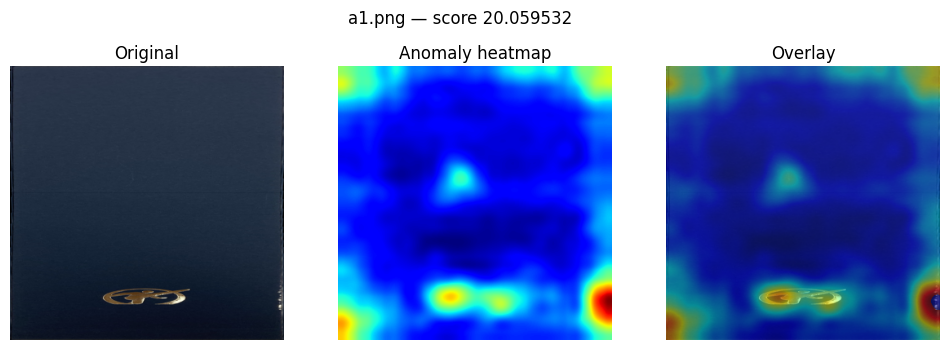

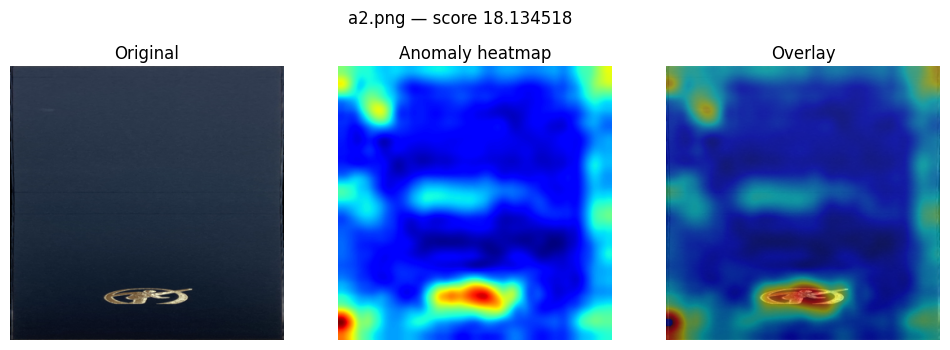

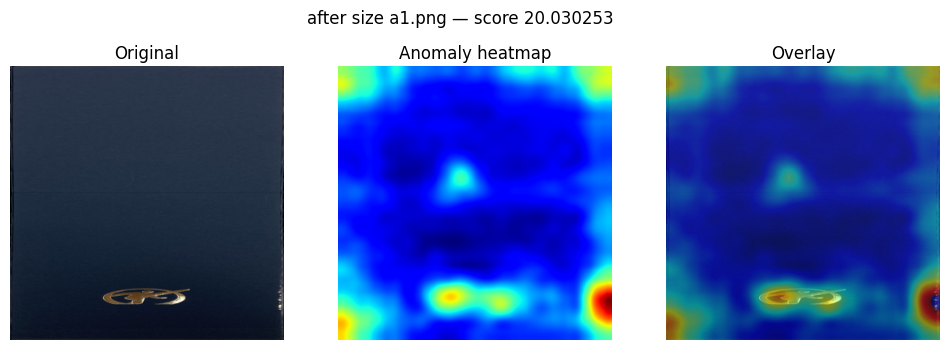

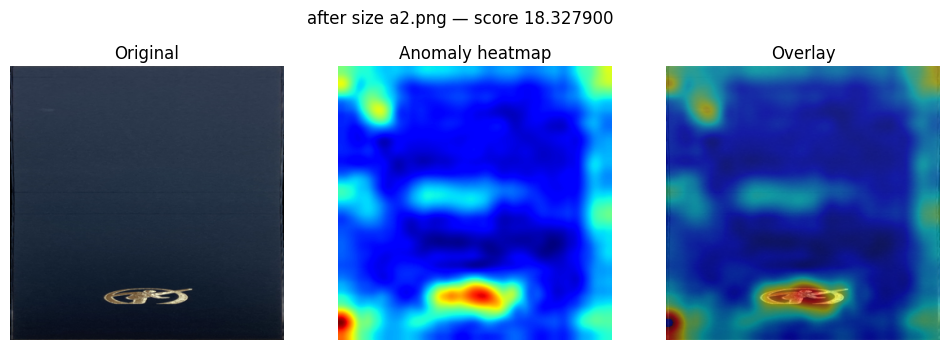

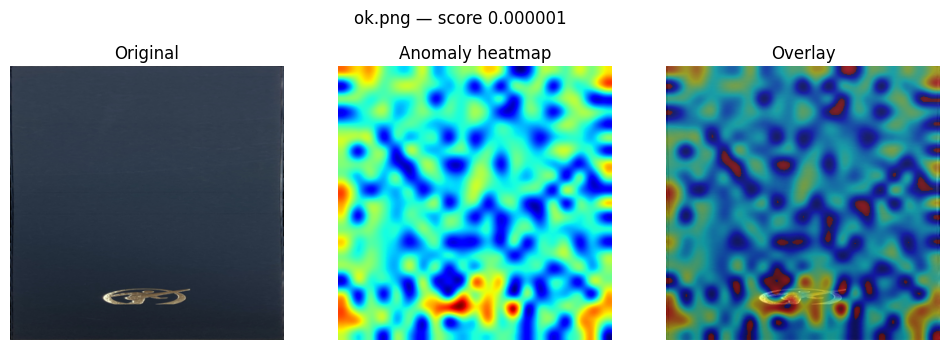

In [ ]:
# Colab cell (python)
def show_overlay(pil_img, heatmap, alpha=0.5):
    img = np.array(pil_img.resize((336,336))).astype(np.uint8)
    hm = (255 * heatmap).astype(np.uint8)
    hm_color = cv2.applyColorMap(hm, cv2.COLORMAP_JET)[:,:,::-1]
    overlay = (img * (1-alpha) + hm_color * alpha).astype(np.uint8)
    return overlay


for i, (p, pil, heatmap, score) in enumerate(results):
    plt.figure(figsize=(12,4))
    plt.suptitle(f"{os.path.basename(p)} — score {score:.6f}")
    plt.subplot(1,3,1)
    plt.imshow(pil)
    plt.title("Original"); plt.axis('off')
    plt.subplot(1,3,2)
    plt.imshow(heatmap, cmap='jet')
    plt.title("Anomaly heatmap"); plt.axis('off')
    plt.subplot(1,3,3)
    plt.imshow(show_overlay(pil, heatmap))
    plt.title("Overlay"); plt.axis('off')
    plt.show()



In [ ]:
def refine_mask(heatmap, smooth=1):
    # small Gaussian to remove noise, but retain structure
    refined = cv2.GaussianBlur(heatmap, (3,3), smooth)
    refined = np.clip(refined, 0, 1)
    return refined


#Option 1: PaDiM (Patch Distribution Modeling) - More Robust

Torch: 2.8.0+cu126 CUDA: False
Config: 8 3000 3 wide_resnet50_2 2
Feature shapes from backbone: [(1, 64, 224, 224), (1, 256, 112, 112), (1, 512, 56, 56), (1, 1024, 28, 28), (1, 2048, 14, 14)]
Building memory bank from support images...
Total patches from support: (9408, 512)
Performing K-means clustering for coreset...
Memory bank shape: (3000, 512)
NearestNeighbors trained on memory bank.

RUNNING ANOMALY DETECTION AND SEGMENTATION

Processing: a1.png
Anomaly score: 0.205744
Anomaly regions: 34.32% of image


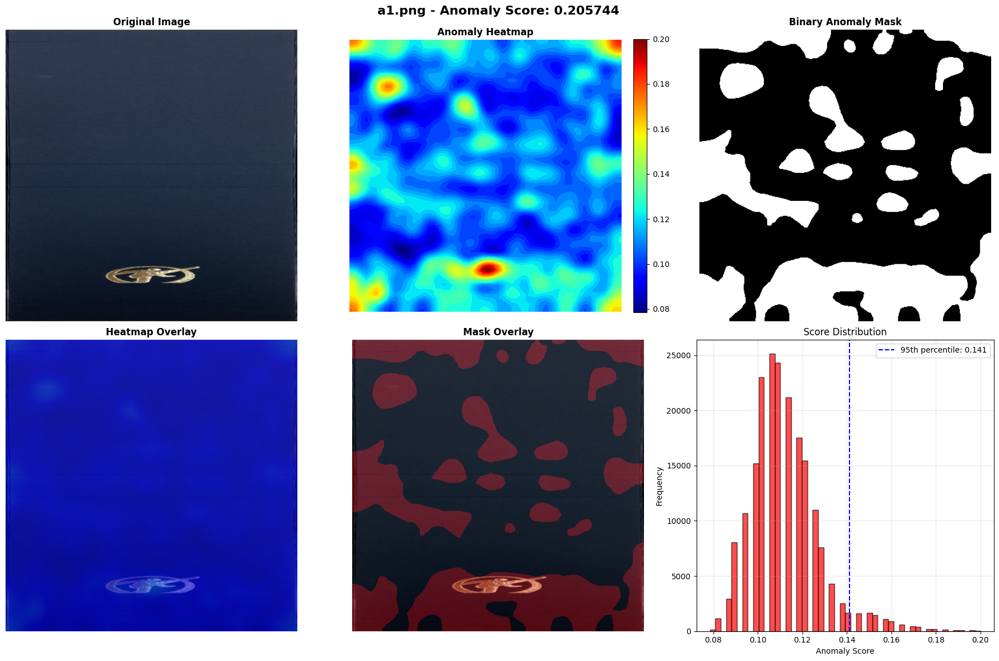


Processing: a2.png
Anomaly score: 0.244671
Anomaly regions: 14.57% of image


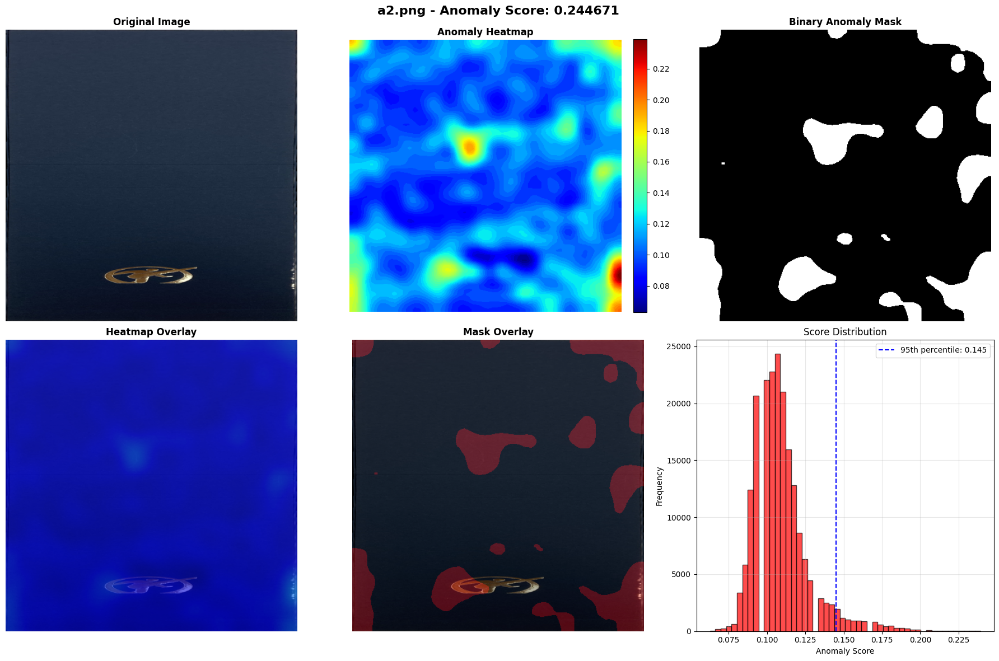


Processing: after size a1.png
Anomaly score: 0.244172
Anomaly regions: 19.04% of image


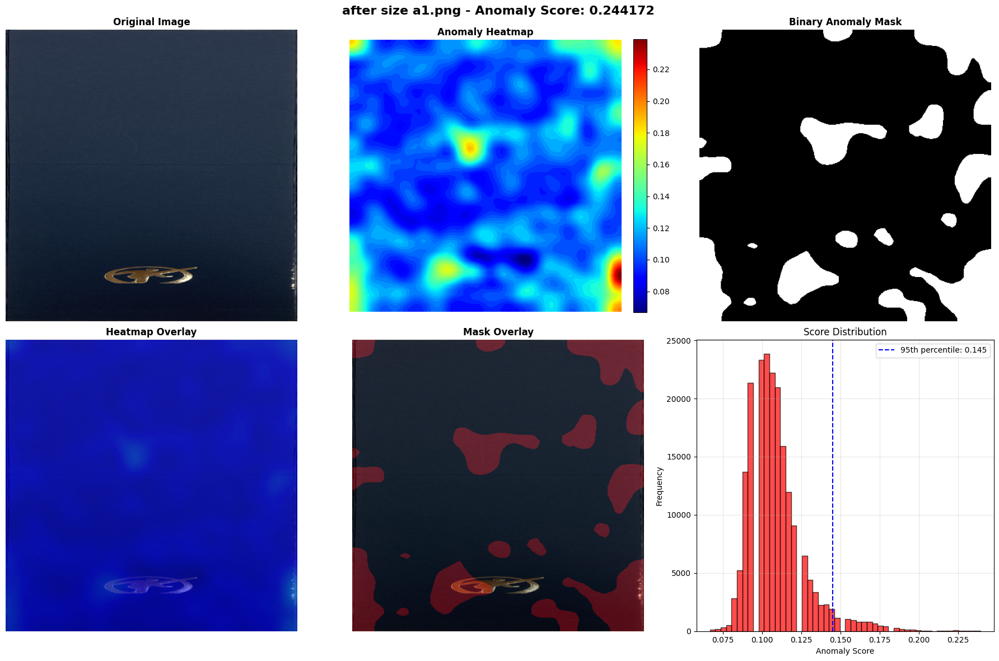


Processing: after size a2.png
Anomaly score: 0.207076
Anomaly regions: 35.59% of image


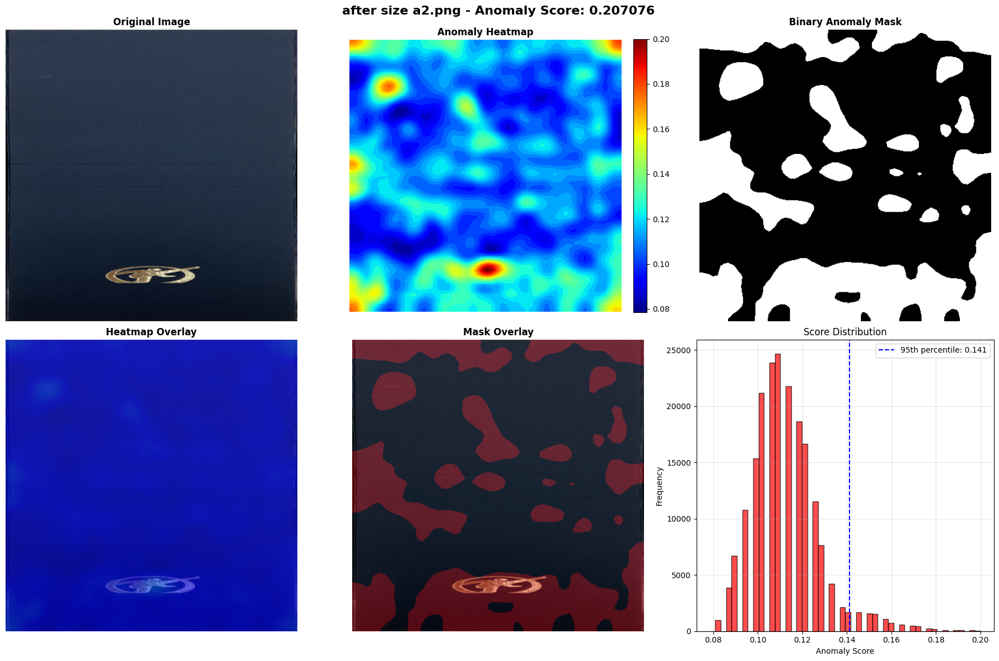


Processing: ok - Copy.png
Anomaly score: 0.011758
Anomaly regions: 8.74% of image


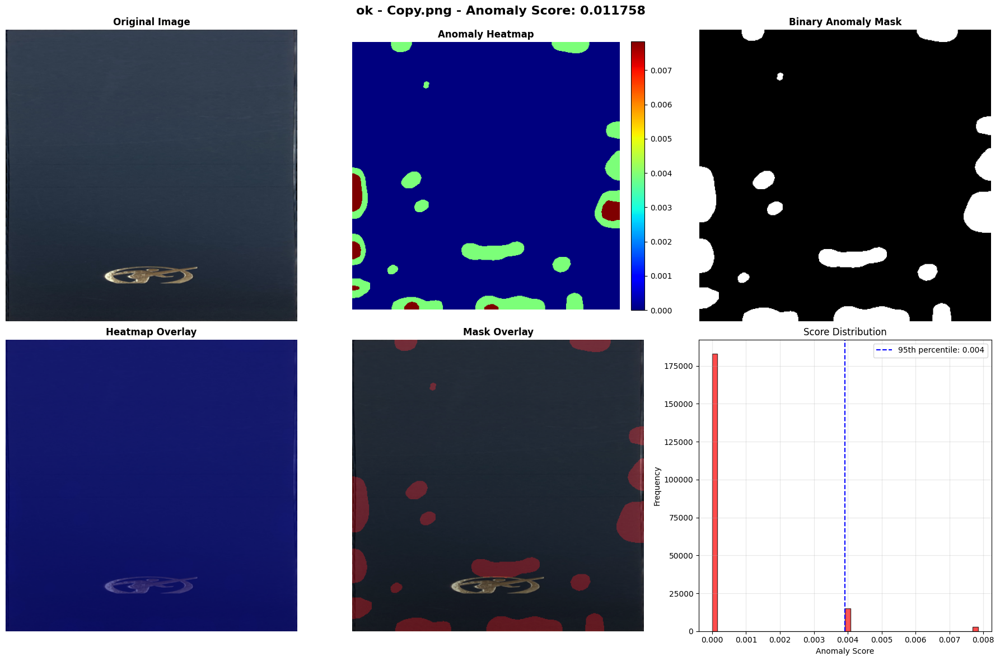


SUMMARY STATISTICS
a1.png: 0.205744 -> NORMAL
a2.png: 0.244671 -> ANOMALY
after size a1.png: 0.244172 -> ANOMALY
after size a2.png: 0.207076 -> NORMAL
ok - Copy.png: 0.011758 -> NORMAL

Suggested threshold: 0.244172
Images above threshold are likely anomalies


In [ ]:
import os
import glob
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms
import timm
import cv2
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from PIL import Image
import warnings
warnings.filterwarnings('ignore')

print("Torch:", torch.__version__, "CUDA:", torch.cuda.is_available())
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Create folders if they don't exist
os.makedirs('support', exist_ok=True)
os.makedirs('test', exist_ok=True)

# Configuration
BACKBONE = "wide_resnet50_2"  # More powerful backbone
FEATURE_LAYER_INDEX = 2       # Middle layer for good balance
K_SHOT = 8                    # Use more support images
SAMPLE_PATCHES = 3000         # More patches for better representation
NN_NEIGHBORS = 3              # Multiple neighbors for smoother results

print("Config:", K_SHOT, SAMPLE_PATCHES, NN_NEIGHBORS, BACKBONE, FEATURE_LAYER_INDEX)

# Load model
model = timm.create_model(BACKBONE, pretrained=True, features_only=True)
model.eval()
model.to(device)

# Test feature extraction
with torch.no_grad():
    x = torch.randn(1, 3, 448, 448).to(device)
    feats = model(x)
    shapes = [tuple(f.shape) for f in feats]
print("Feature shapes from backbone:", shapes)

# Improved preprocessing with higher resolution
def load_image(path, resize=(448, 448)):
    """Load and resize image"""
    img = Image.open(path).convert('RGB')
    img = img.resize(resize)
    return img

transform = transforms.Compose([
    transforms.Resize((448, 448)),
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])

def extract_normalized_features(img_pil):
    """Extract and normalize features"""
    img_t = transform(img_pil).unsqueeze(0).to(device)
    with torch.no_grad():
        feats = model(img_t)
        feat = feats[FEATURE_LAYER_INDEX]  # (1, C, H, W)
        # L2 normalize along channel dimension
        feat = F.normalize(feat, p=2, dim=1)
        return feat.squeeze(0).cpu().numpy()  # (C, H, W)

def feat_to_patches(feat):
    """Convert feature map to patch vectors"""
    C, H, W = feat.shape
    patches = feat.reshape(C, H * W).T  # (H*W, C)
    return patches, (H, W)

# Build memory bank from support images
support_paths = sorted(glob.glob('support/*'))[:K_SHOT]
assert len(support_paths) > 0, "No support images found!"

print("Building memory bank from support images...")
all_patches = []
for p in support_paths:
    pil = load_image(p, resize=(448, 448))
    feat = extract_normalized_features(pil)
    patches, hw = feat_to_patches(feat)
    all_patches.append(patches)

all_patches = np.vstack(all_patches)
print(f"Total patches from support: {all_patches.shape}")

# Smart sampling using K-means for better representation
if all_patches.shape[0] > SAMPLE_PATCHES:
    print("Performing K-means clustering for coreset...")
    kmeans = KMeans(n_clusters=SAMPLE_PATCHES, random_state=42, n_init=10)
    kmeans.fit(all_patches)
    memory = kmeans.cluster_centers_
else:
    memory = all_patches

print(f"Memory bank shape: {memory.shape}")

# Use cosine distance for normalized features
from sklearn.neighbors import NearestNeighbors
nn = NearestNeighbors(n_neighbors=NN_NEIGHBORS, metric='cosine')
nn.fit(memory)
print("NearestNeighbors trained on memory bank.")

def post_process_heatmap(heatmap, kernel_size=5):
    """Clean up heatmap using morphological operations"""
    # Convert to uint8 for OpenCV operations
    heatmap_uint8 = (heatmap * 255).astype(np.uint8)

    # Apply morphological opening to remove small noise
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))
    cleaned = cv2.morphologyEx(heatmap_uint8, cv2.MORPH_OPEN, kernel)

    # Apply Gaussian blur for smoothness
    cleaned = cv2.GaussianBlur(cleaned, (5, 5), 1.0)

    return cleaned.astype(np.float32) / 255.0

def create_anomaly_mask(heatmap, threshold_method='adaptive'):
    """Create binary anomaly mask from heatmap"""
    if threshold_method == 'adaptive':
        # Use Otsu's method for adaptive thresholding
        heatmap_uint8 = (heatmap * 255).astype(np.uint8)
        _, binary_mask = cv2.threshold(heatmap_uint8, 0, 255,
                                     cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    else:
        # Fixed threshold
        binary_mask = (heatmap > 0.3).astype(np.uint8) * 255

    return binary_mask

def show_detailed_results(original_img, heatmap, binary_mask, anomaly_score, filename):
    """Comprehensive visualization of results"""
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'{filename} - Anomaly Score: {anomaly_score:.6f}', fontsize=16, fontweight='bold')

    # Original image
    axes[0, 0].imshow(original_img)
    axes[0, 0].set_title('Original Image', fontsize=12, fontweight='bold')
    axes[0, 0].axis('off')

    # Raw heatmap
    im1 = axes[0, 1].imshow(heatmap, cmap='jet')
    axes[0, 1].set_title('Anomaly Heatmap', fontsize=12, fontweight='bold')
    axes[0, 1].axis('off')
    plt.colorbar(im1, ax=axes[0, 1], fraction=0.046, pad=0.04)

    # Binary mask
    axes[0, 2].imshow(binary_mask, cmap='gray')
    axes[0, 2].set_title('Binary Anomaly Mask', fontsize=12, fontweight='bold')
    axes[0, 2].axis('off')

    # Overlay heatmap on original
    overlay_heatmap = create_overlay(original_img, heatmap, alpha=0.6)
    axes[1, 0].imshow(overlay_heatmap)
    axes[1, 0].set_title('Heatmap Overlay', fontsize=12, fontweight='bold')
    axes[1, 0].axis('off')

    # Overlay binary mask on original
    overlay_mask = create_mask_overlay(original_img, binary_mask, color=(255, 0, 0))
    axes[1, 1].imshow(overlay_mask)
    axes[1, 1].set_title('Mask Overlay', fontsize=12, fontweight='bold')
    axes[1, 1].axis('off')

    # Histogram of anomaly scores
    axes[1, 2].hist(heatmap.flatten(), bins=50, alpha=0.7, color='red', edgecolor='black')
    axes[1, 2].axvline(x=np.percentile(heatmap, 95), color='blue', linestyle='--',
                      label=f'95th percentile: {np.percentile(heatmap, 95):.3f}')
    axes[1, 2].set_xlabel('Anomaly Score')
    axes[1, 2].set_ylabel('Frequency')
    axes[1, 2].set_title('Score Distribution')
    axes[1, 2].legend()
    axes[1, 2].grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

def create_overlay(original_img, heatmap, alpha=0.6):
    """Create heatmap overlay on original image"""
    original_np = np.array(original_img.resize((448, 448)))
    heatmap_resized = cv2.resize(heatmap, (448, 448))

    # Create color heatmap
    heatmap_color = cv2.applyColorMap((heatmap_resized * 255).astype(np.uint8), cv2.COLORMAP_JET)
    heatmap_color = cv2.cvtColor(heatmap_color, cv2.COLOR_BGR2RGB)

    # Blend with original image
    overlay = cv2.addWeighted(original_np, 1 - alpha, heatmap_color, alpha, 0)
    return overlay

def create_mask_overlay(original_img, binary_mask, color=(255, 0, 0)):
    """Create binary mask overlay on original image"""
    original_np = np.array(original_img.resize((448, 448)))
    mask_resized = cv2.resize(binary_mask, (448, 448))

    # Create colored mask
    mask_color = np.zeros_like(original_np)
    mask_color[mask_resized > 0] = color

    # Blend with original
    overlay = cv2.addWeighted(original_np, 0.7, mask_color, 0.3, 0)
    return overlay

def infer_with_segmentation(path):
    """Complete inference with segmentation"""
    # Load and process image
    original_img = load_image(path, resize=(448, 448))
    feat = extract_normalized_features(original_img)
    patches, (Hf, Wf) = feat_to_patches(feat)

    # Get distances
    dists, idxs = nn.kneighbors(patches, return_distance=True)

    # Use minimum distance for each patch
    patch_scores = dists.min(axis=1).reshape(Hf, Wf)

    # Apply smoothing
    patch_scores_smoothed = cv2.GaussianBlur(patch_scores, (5, 5), sigmaX=1.5)

    # Upsample to image size
    heatmap = cv2.resize(patch_scores_smoothed, (448, 448), interpolation=cv2.INTER_LINEAR)

    # Post-process heatmap
    heatmap_clean = post_process_heatmap(heatmap)

    # Create binary mask
    binary_mask = create_anomaly_mask(heatmap_clean)

    # Calculate image-level anomaly score (using max for better discrimination)
    image_score = np.max(patch_scores_smoothed)

    return original_img, heatmap_clean, binary_mask, image_score

# Run inference on test images
test_paths = sorted(glob.glob('test/*'))
assert len(test_paths) > 0, "No test images found!"

print("\n" + "="*60)
print("RUNNING ANOMALY DETECTION AND SEGMENTATION")
print("="*60)

results = []
for path in test_paths:
    filename = os.path.basename(path)
    print(f"\nProcessing: {filename}")

    original_img, heatmap, binary_mask, score = infer_with_segmentation(path)
    results.append((filename, original_img, heatmap, binary_mask, score))

    print(f"Anomaly score: {score:.6f}")
    print(f"Anomaly regions: {np.sum(binary_mask > 0) / (448*448) * 100:.2f}% of image")

    # Display detailed results
    show_detailed_results(original_img, heatmap, binary_mask, score, filename)

# Summary statistics
print("\n" + "="*60)
print("SUMMARY STATISTICS")
print("="*60)
scores = [r[4] for r in results]
filenames = [r[0] for r in results]

for filename, score in zip(filenames, scores):
    status = "ANOMALY" if score > np.percentile(scores, 70) else "NORMAL"
    print(f"{filename}: {score:.6f} -> {status}")

# Threshold analysis
if len(scores) > 1:
    optimal_threshold = np.percentile(scores, 75)  # Adjust based on your data
    print(f"\nSuggested threshold: {optimal_threshold:.6f}")
    print("Images above threshold are likely anomalies")

Torch: 2.8.0+cu126 CUDA: False
Found 3 support images and 5 test images

Initializing methods...
Building memory banks and statistical models...
Building Improved Patch Matching...
Building PaDiM...
Building SPADE Segmentation...
Layer 1: Memory bank shape (10000, 256)
Layer 2: Memory bank shape (9408, 512)
Layer 3: Memory bank shape (2352, 1024)

Processing: a1.png
Running Improved Patch Matching...
Running PaDiM...
Running SPADE Segmentation...

Improved Patch Matching Results:


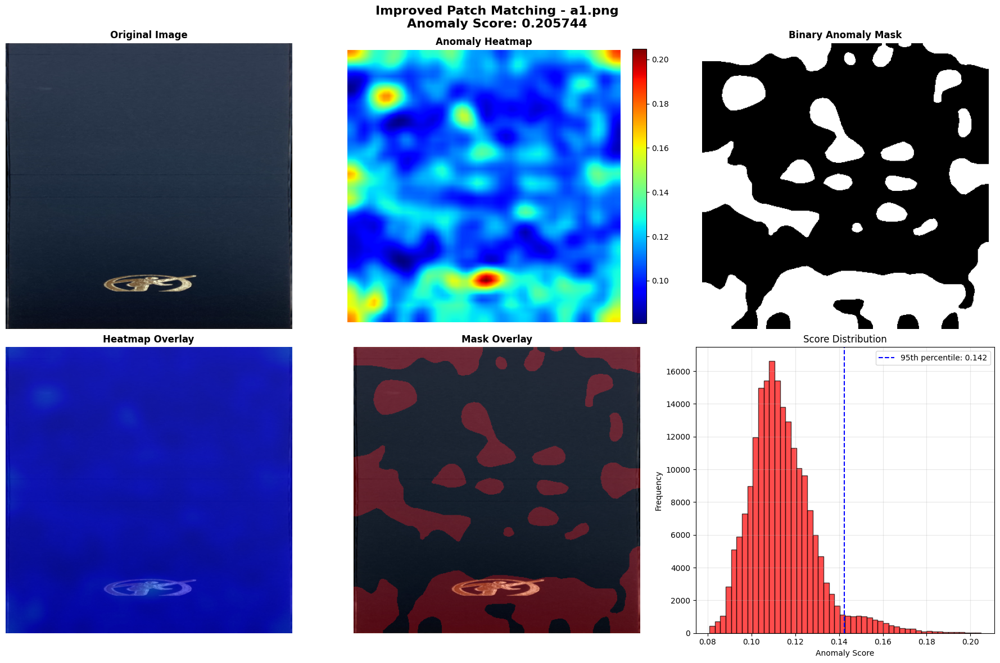


PaDiM Results:


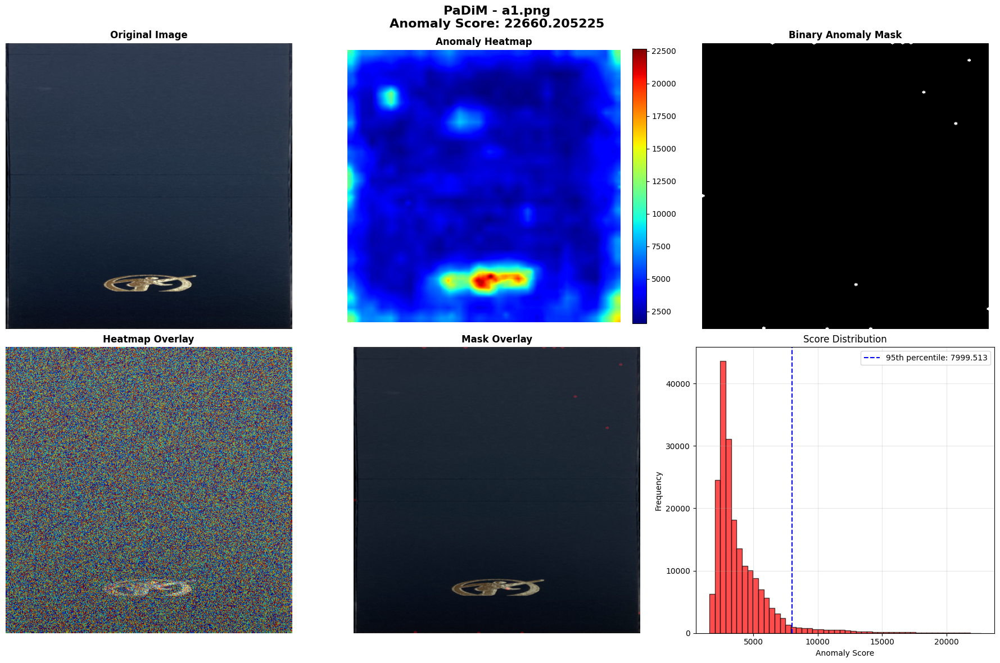


SPADE Segmentation Results:


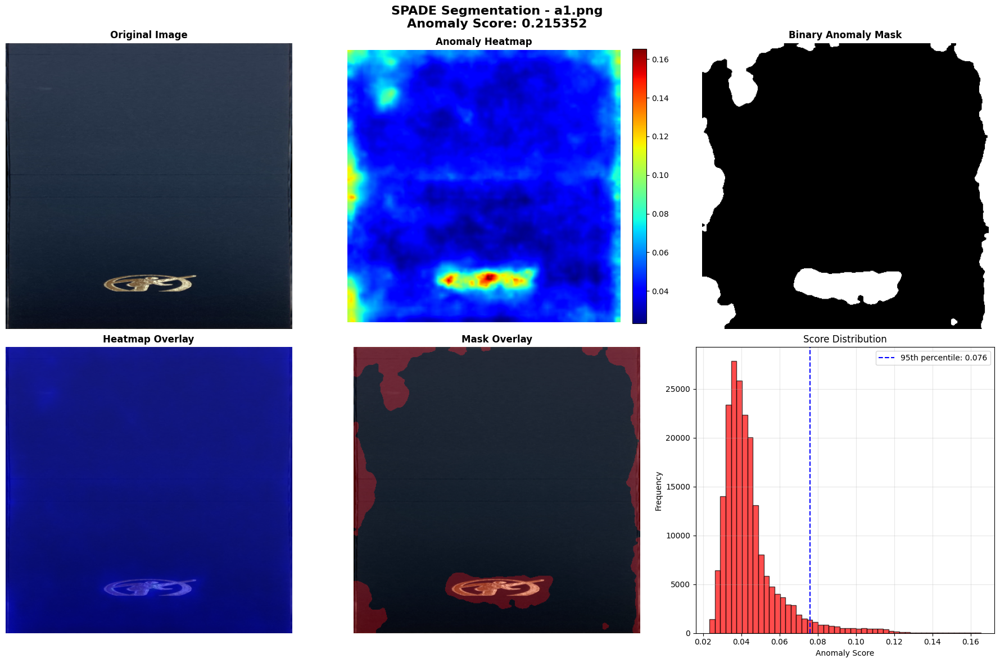


Processing: a2.png
Running Improved Patch Matching...
Running PaDiM...
Running SPADE Segmentation...

Improved Patch Matching Results:


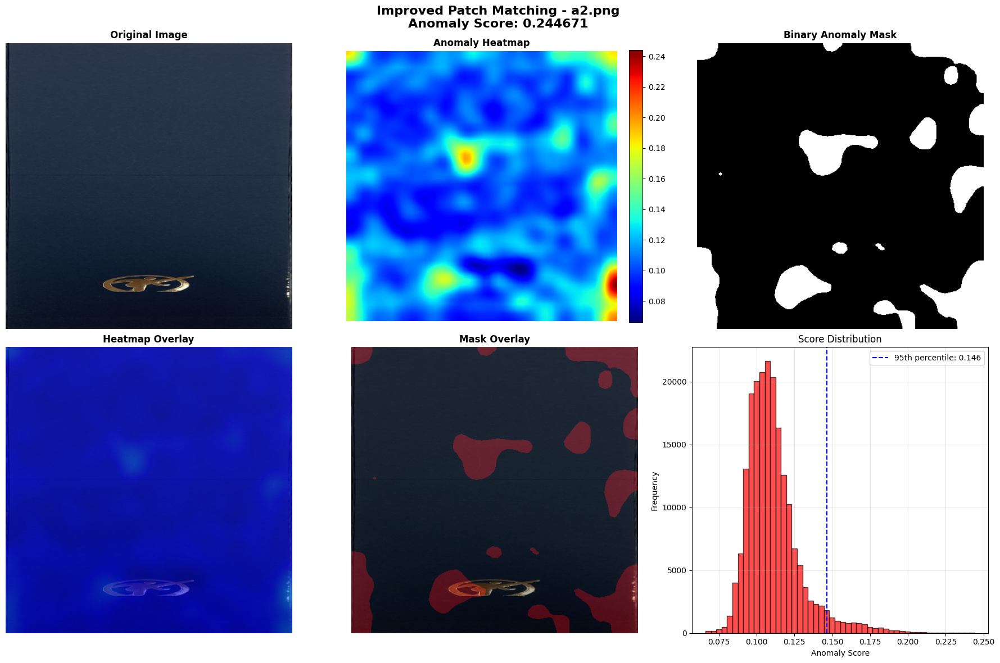


PaDiM Results:


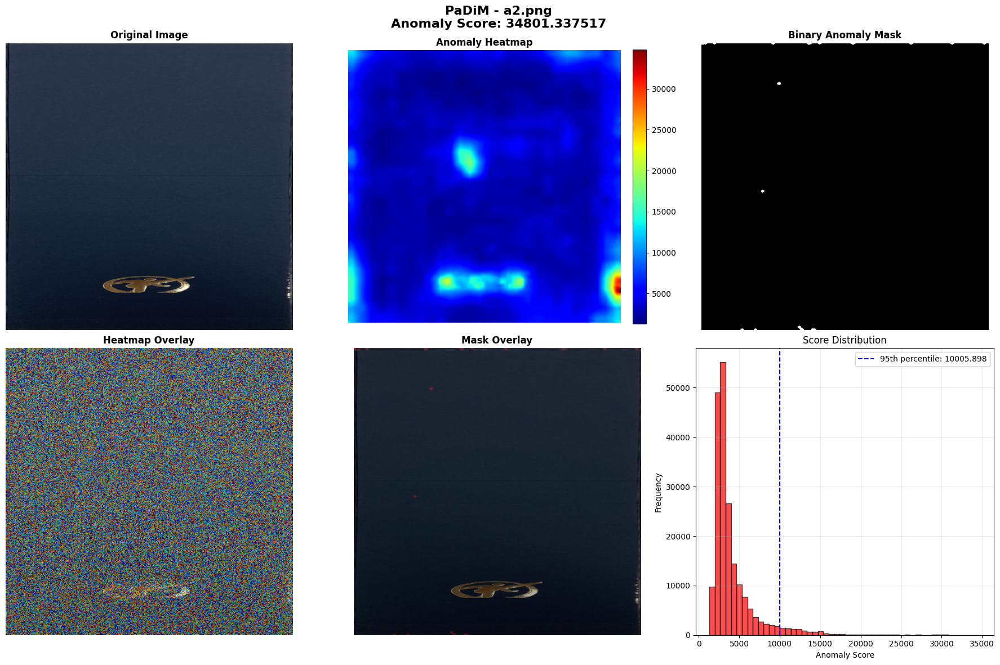


SPADE Segmentation Results:


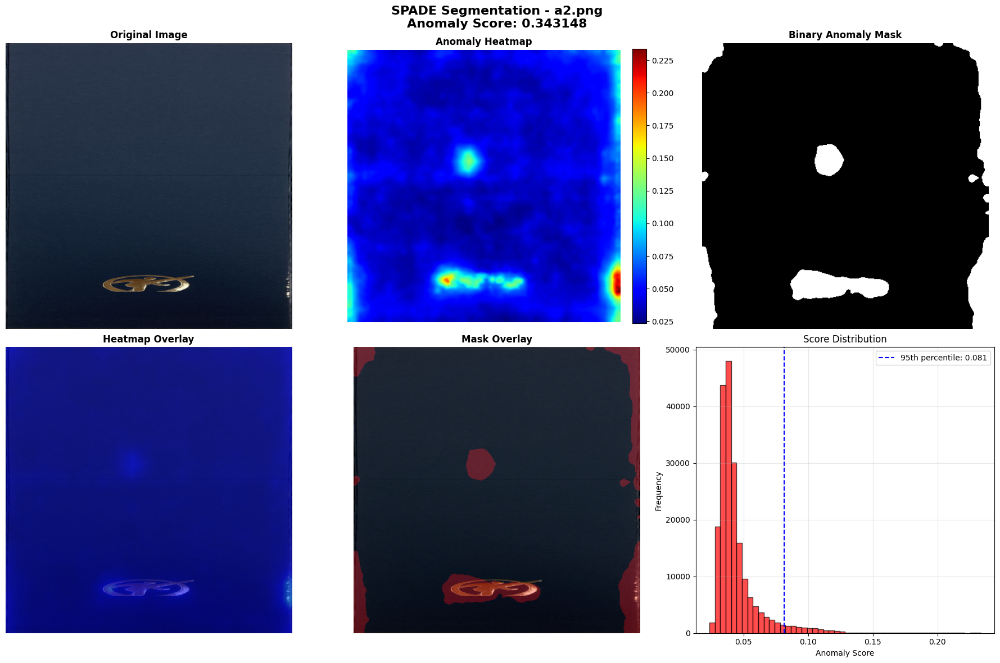


Processing: after size a1.png
Running Improved Patch Matching...
Running PaDiM...
Running SPADE Segmentation...

Improved Patch Matching Results:


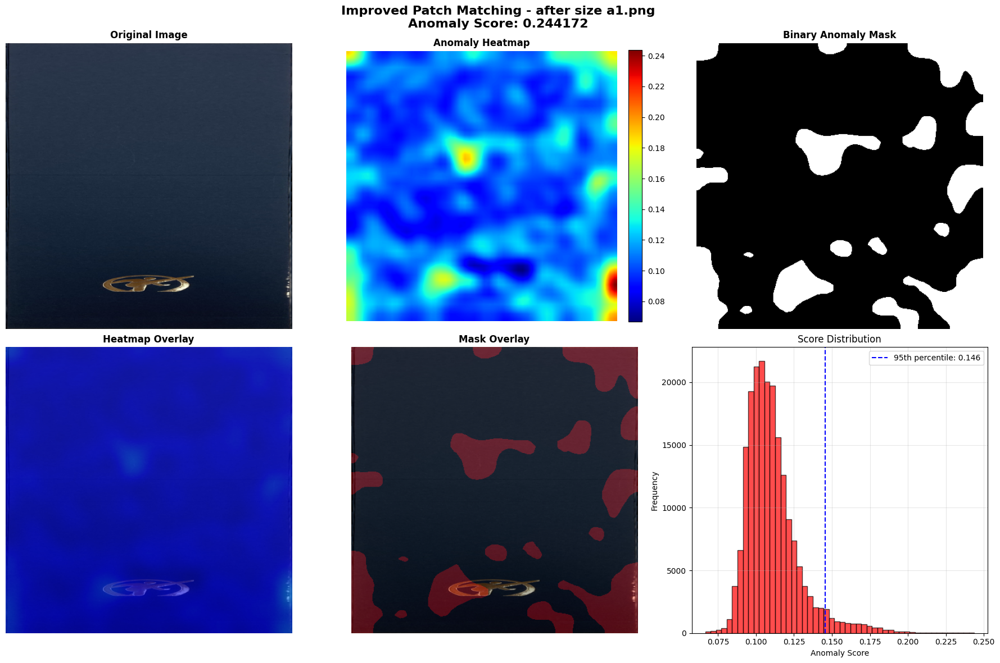


PaDiM Results:


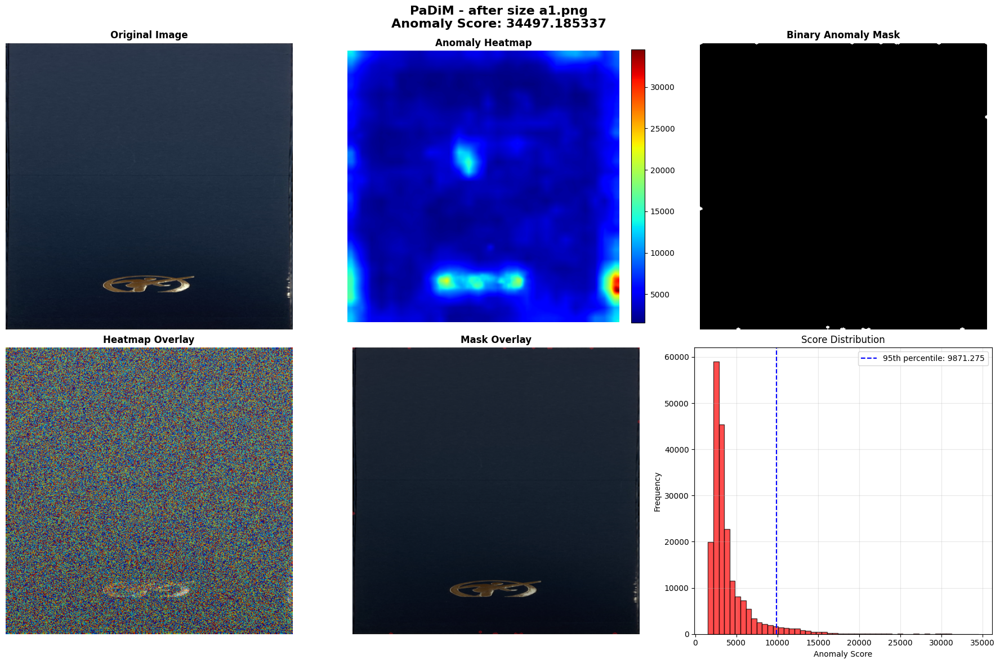


SPADE Segmentation Results:


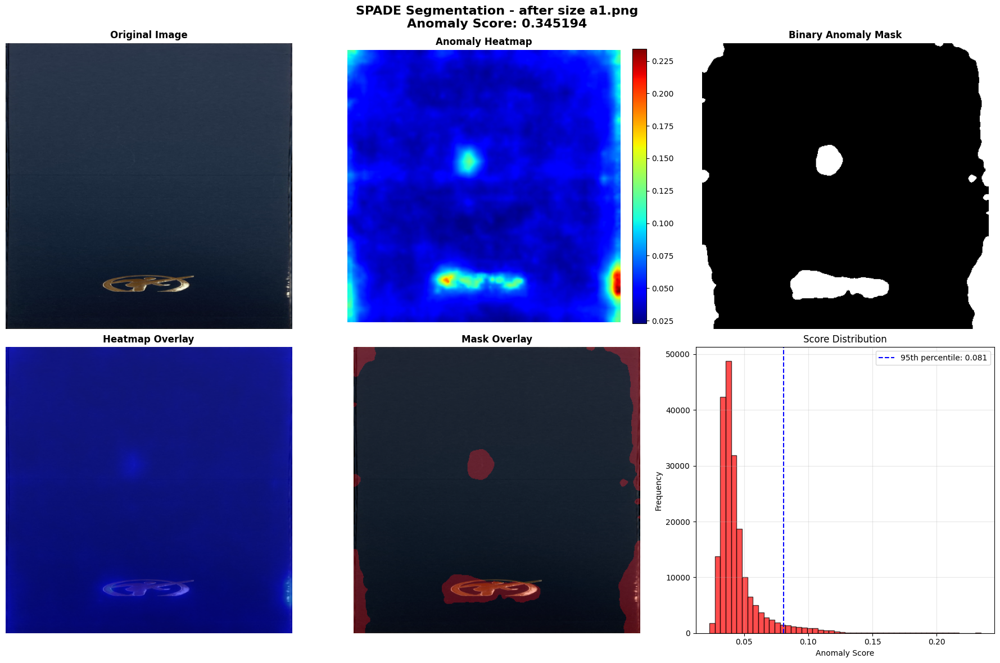


Processing: after size a2.png
Running Improved Patch Matching...
Running PaDiM...
Running SPADE Segmentation...

Improved Patch Matching Results:


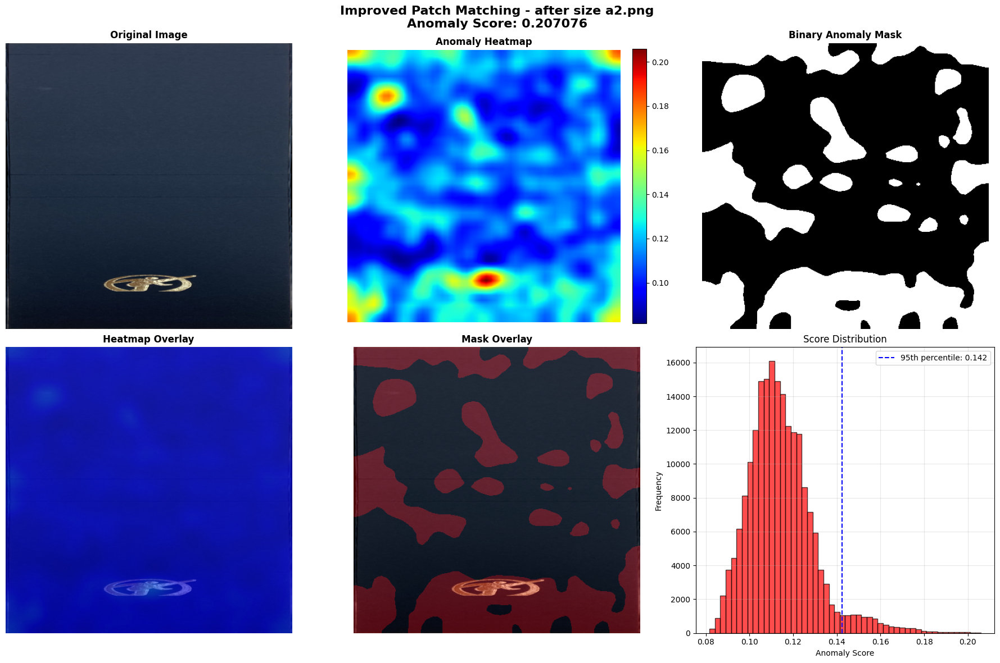


PaDiM Results:


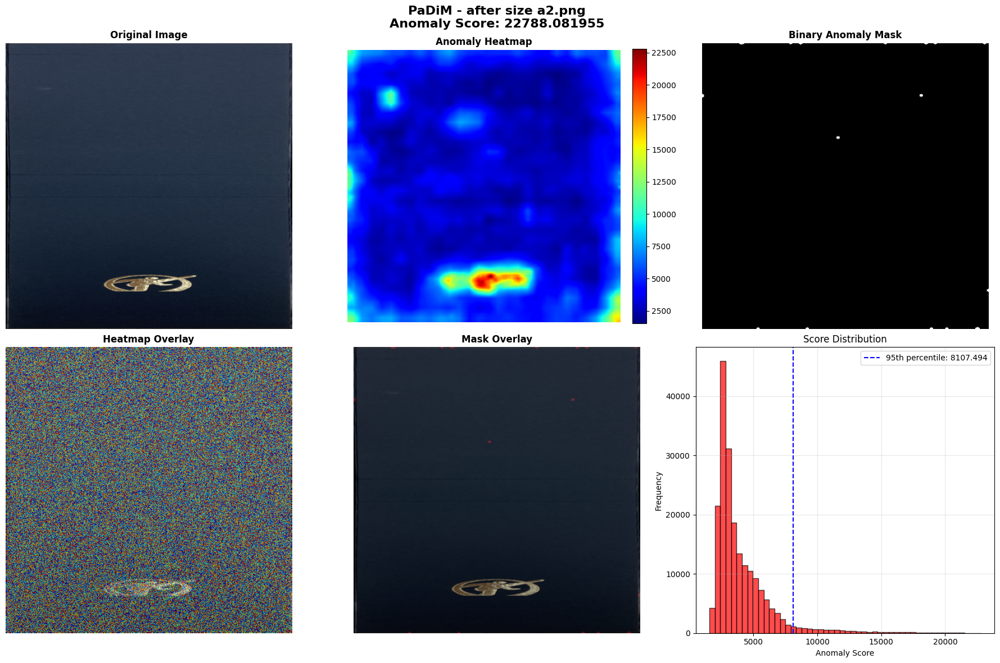


SPADE Segmentation Results:


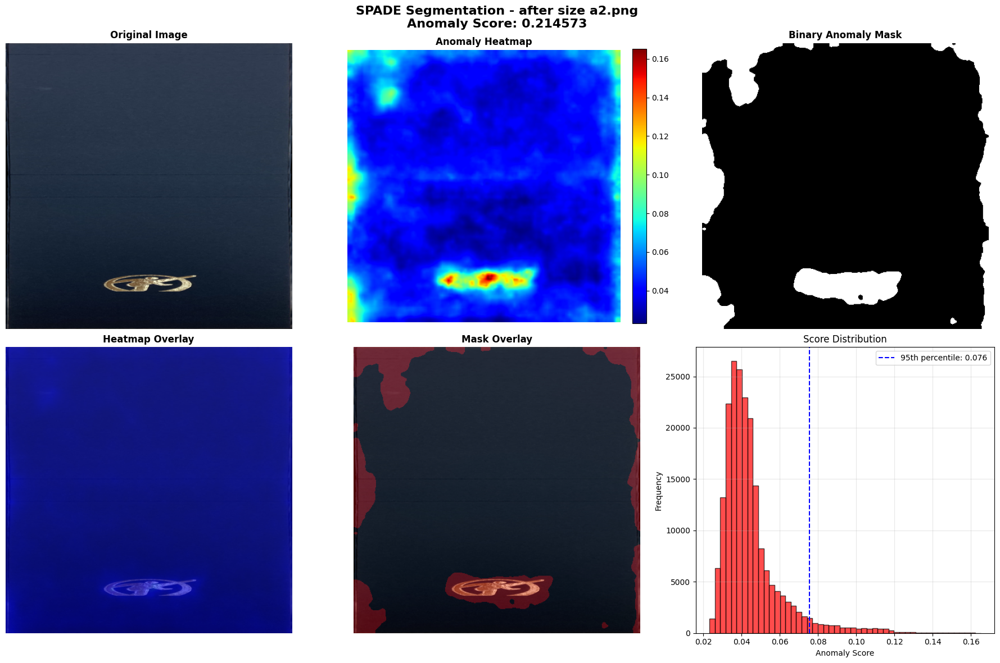


Processing: ok - Copy.png
Running Improved Patch Matching...
Running PaDiM...
Running SPADE Segmentation...

Improved Patch Matching Results:


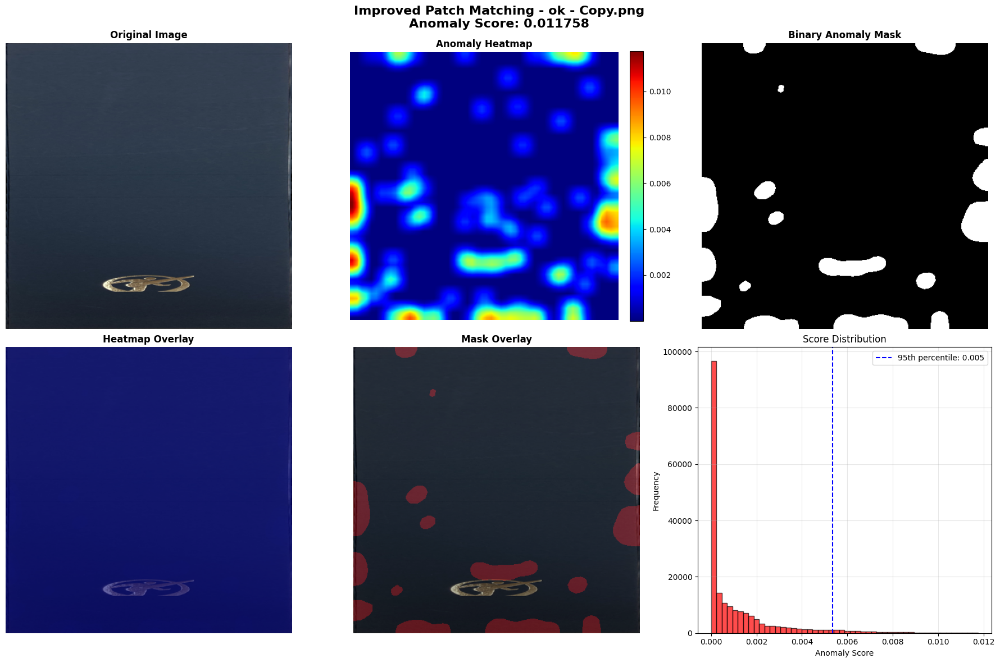


PaDiM Results:


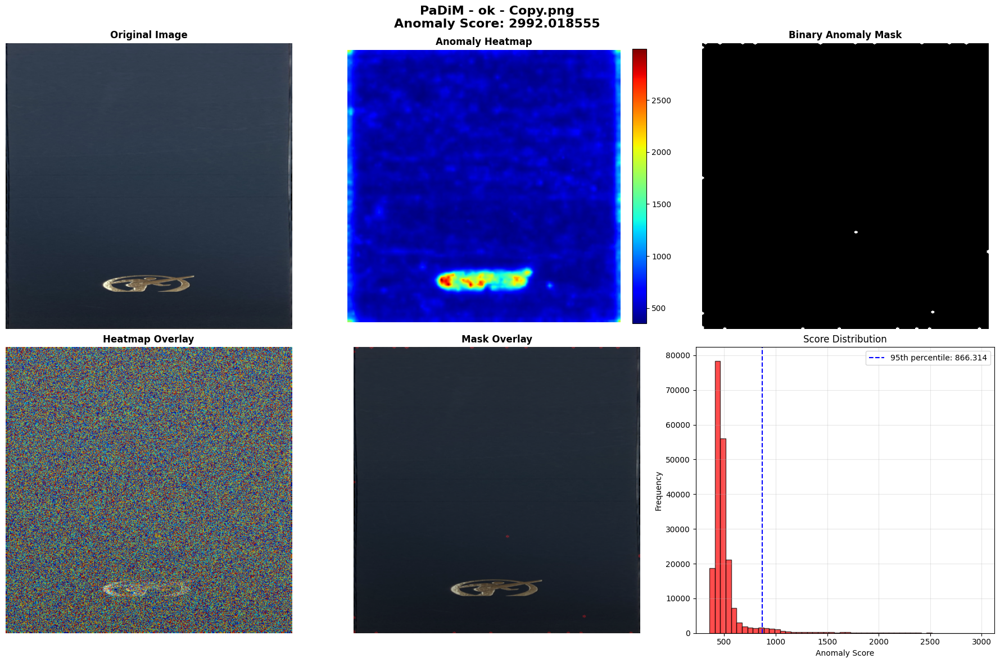


SPADE Segmentation Results:


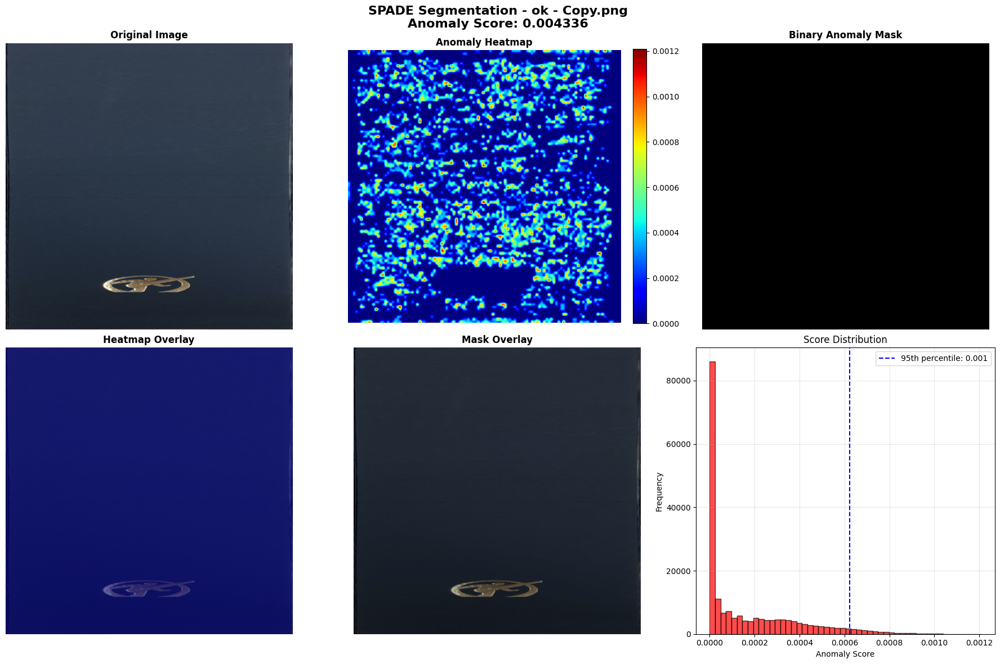


FINAL SUMMARY

a1.png:
  Improved Patch Matching: 0.205744
  PaDiM: 22660.205225
  SPADE Segmentation: 0.215352
  Status: ANOMALY

a2.png:
  Improved Patch Matching: 0.244671
  PaDiM: 34801.337517
  SPADE Segmentation: 0.343148
  Status: ANOMALY

after size a1.png:
  Improved Patch Matching: 0.244172
  PaDiM: 34497.185337
  SPADE Segmentation: 0.345194
  Status: ANOMALY

after size a2.png:
  Improved Patch Matching: 0.207076
  PaDiM: 22788.081955
  SPADE Segmentation: 0.214573
  Status: ANOMALY

ok - Copy.png:
  Improved Patch Matching: 0.011758
  PaDiM: 2992.018555
  SPADE Segmentation: 0.004336
  Status: ANOMALY


In [ ]:
import os
import glob
import numpy as np
import torch
import torch.nn.functional as F
from torchvision import transforms
import timm
import cv2
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from sklearn.covariance import EmpiricalCovariance
import matplotlib.pyplot as plt
from PIL import Image
import warnings
warnings.filterwarnings('ignore')

print("Torch:", torch.__version__, "CUDA:", torch.cuda.is_available())
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Create folders if they don't exist
os.makedirs('support', exist_ok=True)
os.makedirs('test', exist_ok=True)

# ============================================================================
# 1. IMPROVED PATCH MATCHING (Option 3) - FIXED
# ============================================================================

class ImprovedPatchMatching:
    def __init__(self, backbone="wide_resnet50_2", feature_layer=2, k_shot=8, sample_patches=3000):
        self.backbone = backbone
        self.feature_layer = feature_layer
        self.k_shot = k_shot
        self.sample_patches = sample_patches

        self.model = timm.create_model(backbone, pretrained=True, features_only=True)
        self.model.eval()
        self.model.to(device)

        self.transform = transforms.Compose([
            transforms.Resize((448, 448)),
            transforms.ToTensor(),
            transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
        ])

    def load_image(self, path, resize=(448, 448)):
        img = Image.open(path).convert('RGB')
        img = img.resize(resize)
        return img

    def extract_normalized_features(self, img_pil):
        img_t = self.transform(img_pil).unsqueeze(0).to(device)
        with torch.no_grad():
            feats = self.model(img_t)
            feat = feats[self.feature_layer]
            feat = F.normalize(feat, p=2, dim=1)
            return feat.squeeze(0).cpu().numpy()

    def build_memory_bank(self, support_paths):
        all_patches = []
        for p in support_paths:
            pil = self.load_image(p)
            feat = self.extract_normalized_features(pil)
            C, H, W = feat.shape
            patches = feat.reshape(C, H * W).T
            all_patches.append(patches)

        all_patches = np.vstack(all_patches)

        if all_patches.shape[0] > self.sample_patches:
            kmeans = KMeans(n_clusters=self.sample_patches, random_state=42, n_init=10)
            kmeans.fit(all_patches)
            memory = kmeans.cluster_centers_
        else:
            memory = all_patches

        self.nn = NearestNeighbors(n_neighbors=3, metric='cosine')
        self.nn.fit(memory)
        return memory.shape

    def infer(self, test_path):
        pil = self.load_image(test_path)
        feat = self.extract_normalized_features(pil)
        C, Hf, Wf = feat.shape
        patches = feat.reshape(C, Hf * Wf).T  # FIXED: Use Hf instead of H

        dists, _ = self.nn.kneighbors(patches)
        patch_scores = dists.min(axis=1).reshape(Hf, Wf)
        patch_scores = cv2.GaussianBlur(patch_scores, (5, 5), 1.5)

        heatmap = cv2.resize(patch_scores, (448, 448), interpolation=cv2.INTER_LINEAR)
        image_score = np.max(patch_scores)

        return pil, heatmap, image_score

# ============================================================================
# 2. PADIM (Patch Distribution Modeling) - FIXED
# ============================================================================

class PaDiM:
    def __init__(self, backbone="wide_resnet50_2", device="cpu"):
        self.device = device
        self.model = timm.create_model(backbone, pretrained=True, features_only=True)
        self.model.eval()
        self.model.to(device)

        self.layers_indices = [1, 2, 3]  # Multi-scale features
        self.transform = transforms.Compose([
            transforms.Resize((448, 448)),
            transforms.ToTensor(),
            transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
        ])

    def load_image(self, path, resize=(448, 448)):
        img = Image.open(path).convert('RGB')
        img = img.resize(resize)
        return img

    def extract_features(self, image_paths):
        all_features = []

        for path in image_paths:
            img = self.load_image(path)
            img_tensor = self.transform(img).unsqueeze(0).to(self.device)

            with torch.no_grad():
                features = self.model(img_tensor)
                multi_scale_feats = {}

                for idx in self.layers_indices:
                    feat = features[idx].squeeze(0)  # (C, H, W)
                    # L2 normalize - FIXED: use keepdim instead of keepdims
                    feat_norm = feat / (torch.norm(feat, p=2, dim=0, keepdim=True) + 1e-8)
                    multi_scale_feats[idx] = feat_norm.cpu().numpy()

            all_features.append(multi_scale_feats)

        return all_features

    def build_statistical_model(self, support_features):
        self.means = {}
        self.covariances = {}

        for layer_idx in self.layers_indices:
            layer_feats = [feat[layer_idx] for feat in support_features]
            # Stack all features for this layer
            all_patches = np.concatenate([f.reshape(f.shape[0], -1).T for f in layer_feats], axis=0)

            mean = np.mean(all_patches, axis=0)
            cov = EmpiricalCovariance().fit(all_patches).covariance_

            self.means[layer_idx] = mean
            self.covariances[layer_idx] = cov

    def compute_anomaly_map(self, test_image_path):
        img = self.load_image(test_image_path)
        img_tensor = self.transform(img).unsqueeze(0).to(self.device)

        with torch.no_grad():
            features = self.model(img_tensor)
            anomaly_maps = []

            for layer_idx in self.layers_indices:
                feat = features[layer_idx].squeeze(0).cpu().numpy()  # (C, H, W)
                # Normalize - FIXED: use keepdims=True for numpy
                feat_norm = feat / (np.linalg.norm(feat, axis=0, keepdims=True) + 1e-8)

                H, W = feat_norm.shape[1], feat_norm.shape[2]
                patches = feat_norm.reshape(feat_norm.shape[0], -1).T  # (H*W, C)

                # Compute Mahalanobis distance
                mean = self.means[layer_idx]
                cov = self.covariances[layer_idx]
                inv_cov = np.linalg.pinv(cov)

                diff = patches - mean
                mahal_dist = np.sum(np.dot(diff, inv_cov) * diff, axis=1)

                anomaly_map = mahal_dist.reshape(H, W)
                anomaly_map = cv2.resize(anomaly_map, (448, 448), interpolation=cv2.INTER_LINEAR)
                anomaly_maps.append(anomaly_map)

            combined_map = np.mean(anomaly_maps, axis=0)
            image_score = np.max(combined_map)

            return img, combined_map, image_score

# ============================================================================
# 3. SPADE WITH SEGMENTATION (Updated to produce masks)
# ============================================================================

class SPADESegmentation:
    def __init__(self, backbone="resnet50", device="cpu"):
        self.device = device
        self.model = timm.create_model(backbone, pretrained=True, features_only=True)
        self.model.eval()
        self.model.to(device)

        self.feature_layers = [1, 2, 3]  # Different resolution feature maps
        self.transform = transforms.Compose([
            transforms.Resize((448, 448)),
            transforms.ToTensor(),
            transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
        ])

    def load_image(self, path, resize=(448, 448)):
        img = Image.open(path).convert('RGB')
        img = img.resize(resize)
        return img

    def extract_spatial_features(self, image_paths):
        """Extract spatial features from multiple layers for all support images"""
        all_support_features = {layer_idx: [] for layer_idx in self.feature_layers}

        for path in image_paths:
            img = self.load_image(path)
            img_tensor = self.transform(img).unsqueeze(0).to(self.device)

            with torch.no_grad():
                features = self.model(img_tensor)

                for layer_idx in self.feature_layers:
                    feat = features[layer_idx]  # (1, C, H, W)
                    # Normalize features
                    feat = F.normalize(feat, p=2, dim=1)
                    all_support_features[layer_idx].append(feat.cpu().numpy())

        return all_support_features

    def build_memory_banks(self, support_features):
        """Build memory banks for each feature layer"""
        self.memory_banks = {}
        self.nn_models = {}

        for layer_idx in self.feature_layers:
            layer_feats = support_features[layer_idx]  # List of (1, C, H, W) arrays

            # Combine all spatial locations from all support images
            all_patches = []
            for feat_batch in layer_feats:
                feat = feat_batch[0]  # (C, H, W)
                C, H, W = feat.shape
                patches = feat.reshape(C, H * W).T  # (H*W, C)
                all_patches.append(patches)

            all_patches = np.vstack(all_patches)

            # Sample if too many patches
            if all_patches.shape[0] > 10000:
                kmeans = KMeans(n_clusters=10000, random_state=42, n_init=10)
                kmeans.fit(all_patches)
                memory_bank = kmeans.cluster_centers_
            else:
                memory_bank = all_patches

            self.memory_banks[layer_idx] = memory_bank

            # Build NN model for this layer
            nn_model = NearestNeighbors(n_neighbors=1, metric='cosine')
            nn_model.fit(memory_bank)
            self.nn_models[layer_idx] = nn_model

            print(f"Layer {layer_idx}: Memory bank shape {memory_bank.shape}")

    def compute_anomaly_segmentation(self, test_path):
        """Compute anomaly segmentation map for test image"""
        img = self.load_image(test_path)
        img_tensor = self.transform(img).unsqueeze(0).to(self.device)

        with torch.no_grad():
            features = self.model(img_tensor)

            # Process each feature layer
            layer_anomaly_maps = []
            layer_scores = []

            for layer_idx in self.feature_layers:
                feat = features[layer_idx][0]  # (C, H, W)
                feat = F.normalize(feat, p=2, dim=0)
                feat_np = feat.cpu().numpy()

                C, H, W = feat_np.shape
                patches = feat_np.reshape(C, H * W).T  # (H*W, C)

                # Find nearest neighbors
                nn_model = self.nn_models[layer_idx]
                distances, indices = nn_model.kneighbors(patches)

                # Reshape distances to spatial map
                anomaly_map = distances.reshape(H, W)

                # Upsample to original image size
                anomaly_map_resized = cv2.resize(anomaly_map, (448, 448),
                                               interpolation=cv2.INTER_LINEAR)

                layer_anomaly_maps.append(anomaly_map_resized)
                layer_scores.append(np.max(anomaly_map))  # Use max for layer score

            # Combine multi-scale anomaly maps
            combined_anomaly_map = np.mean(layer_anomaly_maps, axis=0)

            # Image-level score (max across all layers)
            image_score = np.max(layer_scores)

            return img, combined_anomaly_map, image_score

# ============================================================================
# VISUALIZATION FUNCTIONS
# ============================================================================

def create_anomaly_mask(heatmap, threshold_method='adaptive'):
    """Create binary anomaly mask from heatmap"""
    if threshold_method == 'adaptive':
        # Use Otsu's method for adaptive thresholding
        heatmap_uint8 = (heatmap * 255).astype(np.uint8)
        _, binary_mask = cv2.threshold(heatmap_uint8, 0, 255,
                                     cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    else:
        # Fixed threshold (adjust based on your data)
        threshold = np.percentile(heatmap, 95)
        binary_mask = (heatmap > threshold).astype(np.uint8) * 255

    # Clean up the mask with morphological operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel)
    binary_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    return binary_mask

def create_overlay(original_img, heatmap, alpha=0.6):
    """Create heatmap overlay on original image"""
    original_np = np.array(original_img)
    heatmap_resized = cv2.resize(heatmap, (original_np.shape[1], original_np.shape[0]))

    heatmap_color = cv2.applyColorMap((heatmap_resized * 255).astype(np.uint8), cv2.COLORMAP_JET)
    heatmap_color = cv2.cvtColor(heatmap_color, cv2.COLOR_BGR2RGB)

    overlay = cv2.addWeighted(original_np, 1 - alpha, heatmap_color, alpha, 0)
    return overlay

def create_mask_overlay(original_img, binary_mask, color=(255, 0, 0), alpha=0.3):
    """Create binary mask overlay on original image"""
    original_np = np.array(original_img)
    mask_resized = cv2.resize(binary_mask, (original_np.shape[1], original_np.shape[0]))

    # Create colored mask
    mask_color = np.zeros_like(original_np)
    mask_color[mask_resized > 0] = color

    # Blend with original
    overlay = cv2.addWeighted(original_np, 1 - alpha, mask_color, alpha, 0)
    return overlay

def show_detailed_results(original_img, heatmap, binary_mask, anomaly_score, filename, method_name):
    """Comprehensive visualization of results for a single method"""
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'{method_name} - {filename}\nAnomaly Score: {anomaly_score:.6f}',
                 fontsize=16, fontweight='bold')

    # Original image
    axes[0, 0].imshow(original_img)
    axes[0, 0].set_title('Original Image', fontsize=12, fontweight='bold')
    axes[0, 0].axis('off')

    # Raw heatmap
    im1 = axes[0, 1].imshow(heatmap, cmap='jet')
    axes[0, 1].set_title('Anomaly Heatmap', fontsize=12, fontweight='bold')
    axes[0, 1].axis('off')
    plt.colorbar(im1, ax=axes[0, 1], fraction=0.046, pad=0.04)

    # Binary mask
    axes[0, 2].imshow(binary_mask, cmap='gray')
    axes[0, 2].set_title('Binary Anomaly Mask', fontsize=12, fontweight='bold')
    axes[0, 2].axis('off')

    # Overlay heatmap on original
    overlay_heatmap = create_overlay(original_img, heatmap, alpha=0.6)
    axes[1, 0].imshow(overlay_heatmap)
    axes[1, 0].set_title('Heatmap Overlay', fontsize=12, fontweight='bold')
    axes[1, 0].axis('off')

    # Overlay binary mask on original
    overlay_mask = create_mask_overlay(original_img, binary_mask, color=(255, 0, 0))
    axes[1, 1].imshow(overlay_mask)
    axes[1, 1].set_title('Mask Overlay', fontsize=12, fontweight='bold')
    axes[1, 1].axis('off')

    # Histogram of anomaly scores
    axes[1, 2].hist(heatmap.flatten(), bins=50, alpha=0.7, color='red', edgecolor='black')
    axes[1, 2].axvline(x=np.percentile(heatmap, 95), color='blue', linestyle='--',
                      label=f'95th percentile: {np.percentile(heatmap, 95):.3f}')
    axes[1, 2].set_xlabel('Anomaly Score')
    axes[1, 2].set_ylabel('Frequency')
    axes[1, 2].set_title('Score Distribution')
    axes[1, 2].legend()
    axes[1, 2].grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

# ============================================================================
# MAIN EXECUTION - COMPARE ALL METHODS
# ============================================================================

def main():
    # Get image paths
    support_paths = sorted(glob.glob('support/*'))
    test_paths = sorted(glob.glob('test/*'))

    assert len(support_paths) > 0, "No support images found in 'support/' folder!"
    assert len(test_paths) > 0, "No test images found in 'test/' folder!"

    print(f"Found {len(support_paths)} support images and {len(test_paths)} test images")

    # Initialize all methods
    print("\nInitializing methods...")
    patch_match = ImprovedPatchMatching()
    padim = PaDiM(device=device)
    spade_seg = SPADESegmentation(device=device)

    # Build models
    print("Building memory banks and statistical models...")

    # Improved Patch Matching
    print("Building Improved Patch Matching...")
    patch_match.build_memory_bank(support_paths)

    # PaDiM
    print("Building PaDiM...")
    support_features = padim.extract_features(support_paths)
    padim.build_statistical_model(support_features)

    # SPADE Segmentation
    print("Building SPADE Segmentation...")
    support_features_spade = spade_seg.extract_spatial_features(support_paths)
    spade_seg.build_memory_banks(support_features_spade)

    # Test all methods on each test image
    all_scores = {}

    for test_path in test_paths:
        filename = os.path.basename(test_path)
        print(f"\n{'='*80}")
        print(f"Processing: {filename}")
        print('='*80)

        # Run all methods
        print("Running Improved Patch Matching...")
        patch_pil, patch_heatmap, patch_score = patch_match.infer(test_path)
        patch_mask = create_anomaly_mask(patch_heatmap)

        print("Running PaDiM...")
        padim_pil, padim_heatmap, padim_score = padim.compute_anomaly_map(test_path)
        padim_mask = create_anomaly_mask(padim_heatmap)

        print("Running SPADE Segmentation...")
        spade_pil, spade_heatmap, spade_score = spade_seg.compute_anomaly_segmentation(test_path)
        spade_mask = create_anomaly_mask(spade_heatmap)

        # Show results for each method
        print("\nImproved Patch Matching Results:")
        show_detailed_results(patch_pil, patch_heatmap, patch_mask, patch_score, filename, "Improved Patch Matching")

        print("\nPaDiM Results:")
        show_detailed_results(padim_pil, padim_heatmap, padim_mask, padim_score, filename, "PaDiM")

        print("\nSPADE Segmentation Results:")
        show_detailed_results(spade_pil, spade_heatmap, spade_mask, spade_score, filename, "SPADE Segmentation")

        # Store scores
        all_scores[filename] = {
            'patch_matching': patch_score,
            'padim': padim_score,
            'spade_segmentation': spade_score
        }

    # Print summary
    print("\n" + "="*80)
    print("FINAL SUMMARY")
    print("="*80)

    for image_name, scores in all_scores.items():
        print(f"\n{image_name}:")
        print(f"  Improved Patch Matching: {scores['patch_matching']:.6f}")
        print(f"  PaDiM: {scores['padim']:.6f}")
        print(f"  SPADE Segmentation: {scores['spade_segmentation']:.6f}")

        # Determine anomaly status (you can adjust the threshold)
        max_score = max(scores.values())
        if max_score > 0.1:  # Adjust this threshold based on your data
            status = "ANOMALY"
        else:
            status = "NORMAL"
        print(f"  Status: {status}")

if __name__ == "__main__":
    main()

#Option 2: SPADE (Semantic Pyramid Anomaly Detection)

In [ ]:
class SPADE:
    def __init__(self, backbone="resnet50", device="cpu"):
        self.device = device
        self.model = timm.create_model(backbone, pretrained=True, features_only=False)
        self.model.eval()
        self.model.to(device)

        # Hook to get intermediate features
        self.features = {}

        def get_features(name):
            def hook(model, input, output):
                self.features[name] = output
            return hook

        # Register hooks for different layers
        self.model.layer1.register_forward_hook(get_features('layer1'))
        self.model.layer2.register_forward_hook(get_features('layer2'))
        self.model.layer3.register_forward_hook(get_features('layer3'))
        self.model.layer4.register_forward_hook(get_features('layer4'))

    def extract_pyramid_features(self, image_paths, resize=(448, 448)):
        """Extract features from multiple layers"""
        all_gallery_features = {f'layer{i}': [] for i in range(1, 5)}

        for path in image_paths:
            img = Image.open(path).convert('RGB').resize(resize)
            img_tensor = transforms.ToTensor()(img).unsqueeze(0).to(self.device)

            with torch.no_grad():
                _ = self.model(img_tensor)

                for layer_name in ['layer1', 'layer2', 'layer3', 'layer4']:
                    feat = self.features[layer_name]  # (1, C, H, W)
                    # Global average pooling
                    gap_feat = F.adaptive_avg_pool2d(feat, 1).squeeze(-1).squeeze(-1)  # (1, C)
                    gap_feat = F.normalize(gap_feat, p=2, dim=1)
                    all_gallery_features[layer_name].append(gap_feat.cpu().numpy())

        return all_gallery_features

    def compute_anomaly_score(self, test_path, gallery_features, resize=(448, 448)):
        """Compute anomaly score using feature pyramid"""
        img = Image.open(test_path).convert('RGB').resize(resize)
        img_tensor = transforms.ToTensor()(img).unsqueeze(0).to(self.device)

        with torch.no_grad():
            _ = self.model(img_tensor)

            layer_scores = []
            for layer_name in ['layer1', 'layer2', 'layer3', 'layer4']:
                test_feat = self.features[layer_name]
                test_gap = F.adaptive_avg_pool2d(test_feat, 1).squeeze(-1).squeeze(-1)  # (1, C)
                test_gap = F.normalize(test_gap, p=2, dim=1).cpu().numpy()

                gallery_feats = gallery_features[layer_name]  # List of (1, C) arrays
                gallery_feats = np.vstack(gallery_feats)  # (N, C)

                # Find nearest neighbor distance
                distances = np.linalg.norm(gallery_feats - test_gap, axis=1)
                min_distance = np.min(distances)
                layer_scores.append(min_distance)

            # Combine scores from all layers
            pyramid_score = np.mean(layer_scores)
            return img, pyramid_score

# Usage
spade = SPADE(device=device)
support_paths = sorted(glob.glob('support/*'))

print("Extracting pyramid features...")
gallery_features = spade.extract_pyramid_features(support_paths)

# Test
test_paths = sorted(glob.glob('test/*'))
for test_path in test_paths:
    img, score = spade.compute_anomaly_score(test_path, gallery_features)
    print(f"{os.path.basename(test_path)} -> SPADE score: {score:.6f}")

Extracting pyramid features...
a1.png -> SPADE score: 0.149502
a2.png -> SPADE score: 0.125773
after size a1.png -> SPADE score: 0.124837
after size a2.png -> SPADE score: 0.149354
ok - Copy.png -> SPADE score: 0.000000


#Option 3: Simple but Effective Improvements to Your Current Approach

In [ ]:
def improved_patch_matching():
    # Better configuration
    BACKBONE = "wide_resnet50_2"
    FEATURE_LAYER_INDEX = 2  # Middle layer
    K_SHOT = min(10, len(glob.glob('support/*')))  # Use more support images
    SAMPLE_PATCHES = 5000

    # Improved model
    model = timm.create_model(BACKBONE, pretrained=True, features_only=True)
    model.eval()
    model.to(device)

    # Enhanced feature extraction with normalization
    def extract_normalized_features(img_pil):
        img_t = transform(img_pil).unsqueeze(0).to(device)
        with torch.no_grad():
            feats = model(img_t)
            feat = feats[FEATURE_LAYER_INDEX]  # (1, C, H, W)
            # L2 normalize features
            feat = F.normalize(feat, p=2, dim=1)
            return feat.squeeze(0).cpu().numpy()

    # Build memory bank with better sampling
    support_paths = sorted(glob.glob('support/*'))[:K_SHOT]
    all_patches = []

    for p in support_paths:
        pil = load_image(p, resize=(448, 448))  # Higher resolution
        feat = extract_normalized_features(pil)
        patches, hw = feat_to_patches(feat)
        all_patches.append(patches)

    all_patches = np.vstack(all_patches)

    # Use all patches for small sets, otherwise coreset
    if len(all_patches) > SAMPLE_PATCHES:
        # Better sampling: use k-means centers instead of random
        from sklearn.cluster import KMeans
        kmeans = KMeans(n_clusters=SAMPLE_PATCHES, random_state=42)
        kmeans.fit(all_patches)
        memory = kmeans.cluster_centers_
    else:
        memory = all_patches

    # Use cosine distance (better for normalized features)
    from sklearn.neighbors import NearestNeighbors
    nn = NearestNeighbors(n_neighbors=3, metric='cosine')
    nn.fit(memory)

    def enhanced_inference(path):
        pil = load_image(path, resize=(448, 448))
        feat = extract_normalized_features(pil)
        patches, (Hf, Wf) = feat_to_patches(feat)

        # Get distances to multiple neighbors
        dists, idxs = nn.kneighbors(patches, n_neighbors=3)

        # Use minimum distance (most similar neighbor)
        patch_scores = dists.min(axis=1).reshape(Hf, Wf)

        # Apply spatial smoothing
        patch_scores = cv2.GaussianBlur(patch_scores, (5, 5), sigmaX=1.5)

        # Upsample
        heatmap = cv2.resize(patch_scores, (448, 448), interpolation=cv2.INTER_LINEAR)

        # Better image score: use extreme value statistics
        flat_scores = patch_scores.ravel()
        # Use max score instead of top 1% mean
        image_score = np.max(flat_scores)

        return pil, heatmap, image_score

    # Test
    test_paths = sorted(glob.glob('test/*'))
    for p in test_paths:
        pil, heatmap, score = enhanced_inference(p)
        print(f"{os.path.basename(p)} -> Improved score: {score:.6f}")

# Run improved version
improved_patch_matching()

TypeError: load_image() got an unexpected keyword argument 'resize'